In [1]:
import SCProcess as SCP

In [2]:
import scanpy as sc
import harmonypy as hm
import pandas as pd
import anndata as ad
import numpy as np
import scrublet
import matplotlib as mpl
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

In [3]:
def Workflow(adata):
    SCP.QC(adata)
    SCP.DoubletRM(adata)
    SCP.Normalize(adata)
    SCP.Reduction(adata)
    SCP.Integration(adata)
    SCP.DE(adata)

In [4]:
Lyko = sc.read("Anndata/GSE218170.h5ad")
Ji = sc.read("Anndata/GSE144236.h5ad")
Yost = sc.read("Anndata/GSE123813.h5ad")
Zou = sc.read("Anndata/GSE193304.h5ad")

In [5]:
#Separating into tumour and normal
Ji_tumour = Ji[Ji.obs['Condition'] == 'Tumor'].copy()
Ji_normal = Ji[Ji.obs['Condition'] == 'Normal'].copy()

Lyko_tumour = Lyko[Lyko.obs['Condition'] == 'Tumor'].copy()
Lyko_normal = Lyko[Lyko.obs['Condition'] == 'Normal'].copy()

Zou_tumour = Zou[Zou.obs['Condition'] == 'Tumour'].copy()
Zou_normal = Zou[Zou.obs['Condition'] == 'Normal'].copy()

In [6]:
for i in [Lyko, Ji, Yost, Zou]:
    print(i)

AnnData object with n_obs × n_vars = 136490 × 32738
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'Condition', 'Patient'
    layers: 'counts'
AnnData object with n_obs × n_vars = 48164 × 32740
    obs: 'nCount_RNA', 'nFeature_RNA', 'Patient', 'Condition', 'level1_celltype', 'level2_celltype', 'level3_celltype'
AnnData object with n_obs × n_vars = 26016 × 18347
    obs: 'Patient', 'treatment', 'cluster', 'UMAP1', 'UMAP2', 'Condition'
AnnData object with n_obs × n_vars = 134382 × 33538
    obs: 'batch', 'Patient', 'Condition'


In [23]:
a = (Ji.n_obs, Yost.n_obs, Lyko.n_obs, Zou.n_obs)
print(sum(a), "Cells")

345052 Cells


In [7]:
for i in [Ji_tumour, Ji_normal, Lyko_tumour, Lyko_normal, Zou_tumour, Zou_normal]:
    print(i)

AnnData object with n_obs × n_vars = 26299 × 32740
    obs: 'nCount_RNA', 'nFeature_RNA', 'Patient', 'Condition', 'level1_celltype', 'level2_celltype', 'level3_celltype'
AnnData object with n_obs × n_vars = 21865 × 32740
    obs: 'nCount_RNA', 'nFeature_RNA', 'Patient', 'Condition', 'level1_celltype', 'level2_celltype', 'level3_celltype'
AnnData object with n_obs × n_vars = 104847 × 32738
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'Condition', 'Patient'
    layers: 'counts'
AnnData object with n_obs × n_vars = 31643 × 32738
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'Condition', 'Patient'
    layers: 'counts'
AnnData object with n_obs × n_vars = 61894 × 33538
    obs: 'batch', 'Patient', 'Condition'
AnnData object with n_obs × n_vars = 72488 × 33538
    obs: 'batch', 'Patient', 'Condition'


In [8]:
dir(SCP)

['DE',
 'DoubletRM',
 'Integration',
 'Normalize',
 'QC',
 'Reduction',
 'Runall',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__spec__',
 'ad',
 'hm',
 'mpl',
 'np',
 'pd',
 'plt',
 'sc',
 'scrublet',
 'warnings']

       n_genes_by_counts  total_counts  pct_counts_mt  pct_counts_ribo
count       26016.000000  26016.000000   26016.000000     26016.000000
mean         1796.380689   5116.796875       3.479230        23.366529
std           580.260014   2858.093506       1.688006         7.326794
min           331.000000    466.000000       0.000000         0.694981
25%          1439.000000   3603.000000       2.321105        17.992614
50%          1694.000000   4465.000000       3.217862        23.197938
75%          2044.000000   5838.000000       4.339474        28.648253
max          5705.000000  39415.000000       9.991776        55.863125
       n_cells_by_counts   mean_counts  pct_dropout_by_counts  total_counts
count       18347.000000  18347.000000           18347.000000  1.834700e+04
mean         2547.263313      0.278890              90.208859  7.255605e+03
std          4383.678168      1.871396              16.849931  4.868623e+04
min             0.000000      0.000000               0.02

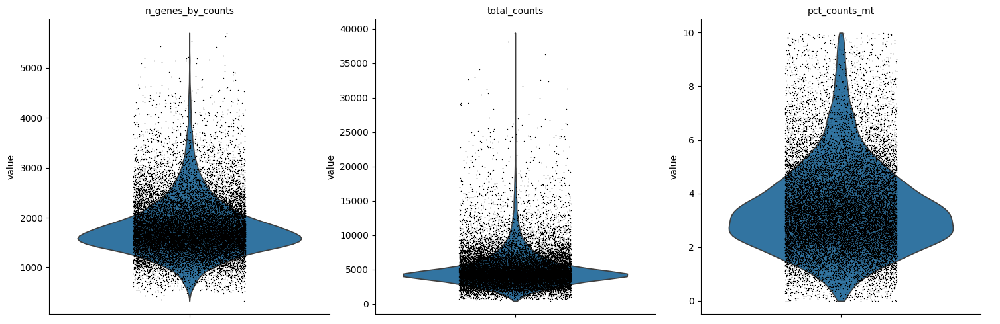

Total number of cells: 26016
Number of cells after mt filter: 26016
Number of cells after gene filter: 26016
Total number of genes: 18347
After mt genes removal:  18334
After ribo genes removal:  18234


In [9]:
SCP.QC(Yost)

In [10]:
SCP.DoubletRM(Yost)

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.76
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 1.3%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 0.6%
Elapsed time: 61.3 seconds
After removing doublets:  26014 cells


In [11]:
SCP.Normalize(Yost)

AnnData HVG dimensions:  (26016, 2000)
AnnData Raw dimensions:  (26016, 18347)


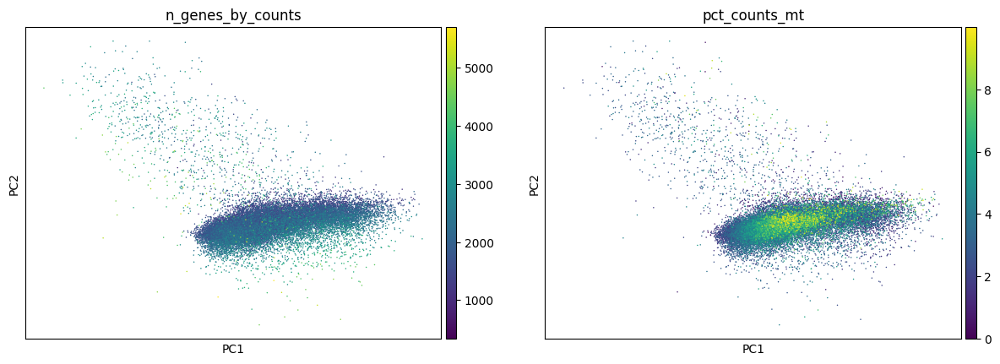

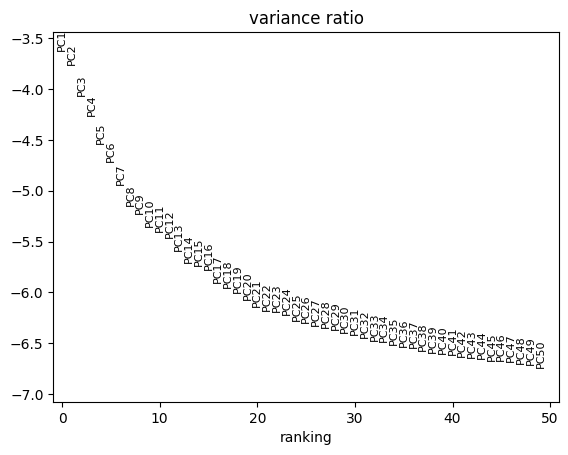

In [12]:
SCP.Reduction(Yost)

2025-06-06 10:39:53,089 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-06-06 10:40:00,338 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-06-06 10:40:00,433 - harmonypy - INFO - Iteration 1 of 20
2025-06-06 10:40:07,255 - harmonypy - INFO - Iteration 2 of 20
2025-06-06 10:40:14,093 - harmonypy - INFO - Converged after 2 iterations


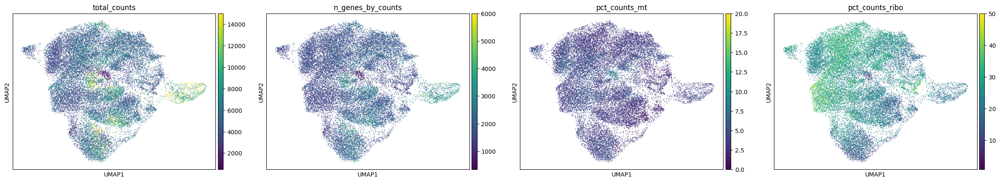

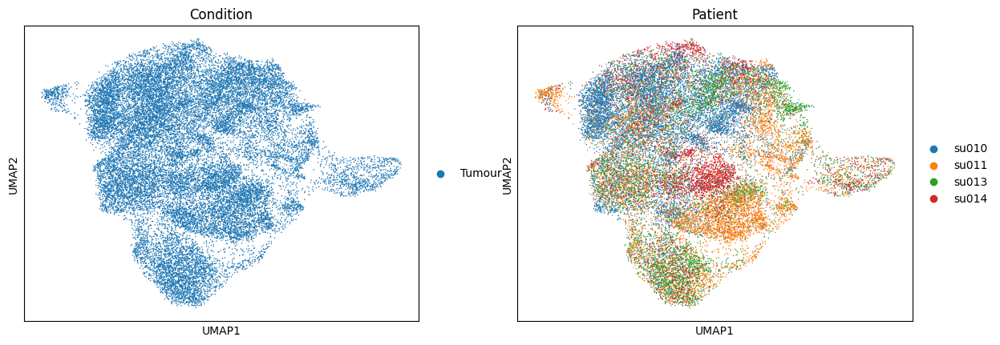

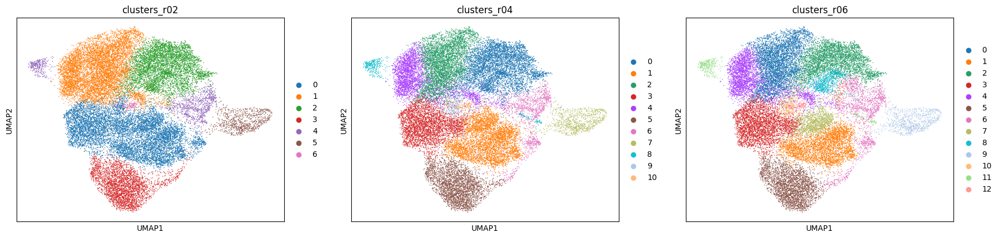

In [13]:
SCP.Integration(Yost)

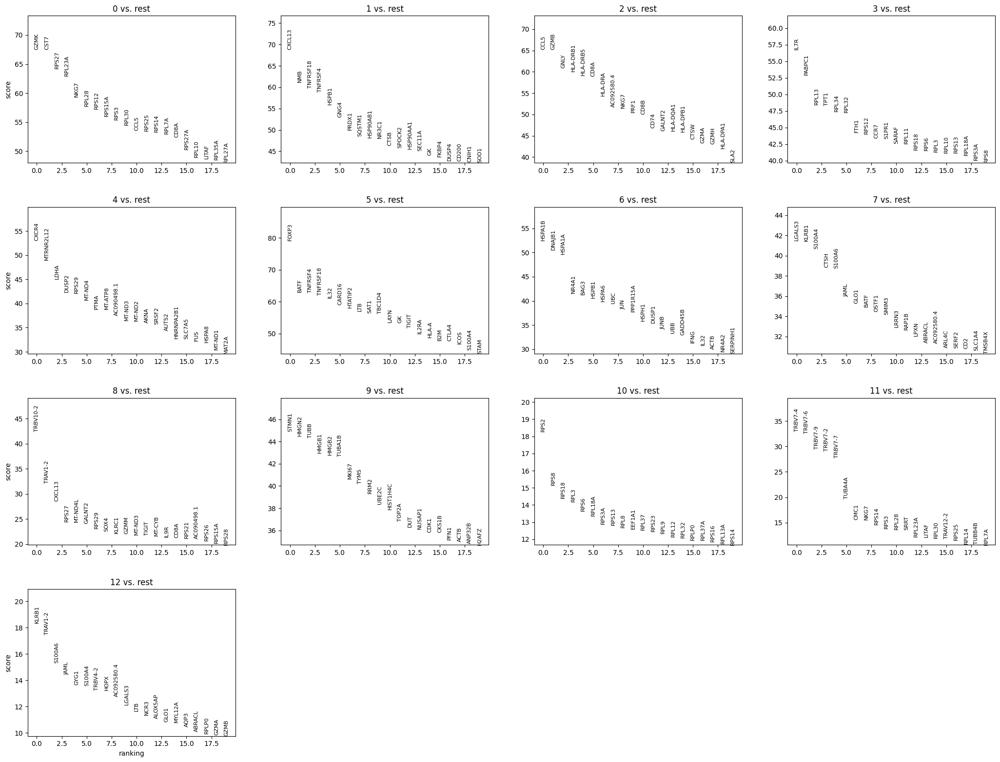

In [14]:
SCP.DE(Yost)

       n_genes_by_counts   total_counts  pct_counts_mt  pct_counts_ribo
count       48164.000000   48164.000000   48164.000000     48164.000000
mean         2722.305560   11737.788224       2.576040        22.890242
std          1090.204394    8759.798481       1.761914         7.627975
min           213.000000     350.000000       0.000000         1.397516
25%          1928.000000    6041.750000       1.349468        17.489428
50%          2532.000000    9275.000000       2.163666        22.514116
75%          3352.000000   14504.250000       3.321551        27.813364
max          8754.000000  121542.000000       9.993850        63.288638
       n_cells_by_counts   mean_counts  pct_dropout_by_counts  total_counts
count       32740.000000  32740.000000           32740.000000  3.274000e+04
mean         4004.799175      0.358515              91.685078  1.726753e+04
std          8005.919695      3.546413              16.622207  1.708095e+05
min             0.000000      0.000000          

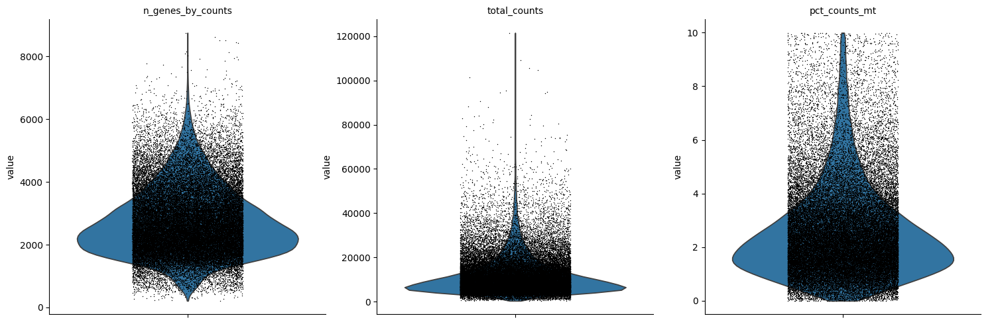

Total number of cells: 48164
Number of cells after mt filter: 48164
Number of cells after gene filter: 48153
Total number of genes: 32740
After mt genes removal:  32727
After ribo genes removal:  32621
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.37
Detected doublet rate = 1.0%
Estimated detectable doublet fraction = 29.3%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 3.4%
Elapsed time: 154.7 seconds
After removing doublets:  47681 cells
AnnData HVG dimensions:  (48164, 2000)
AnnData Raw dimensions:  (48164, 32740)


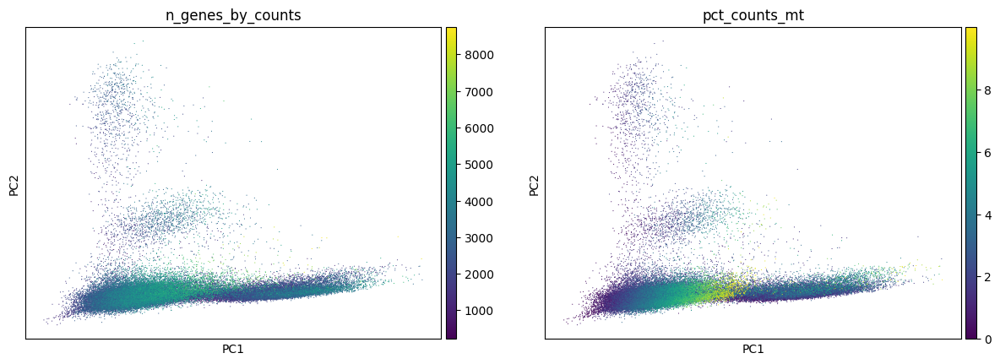

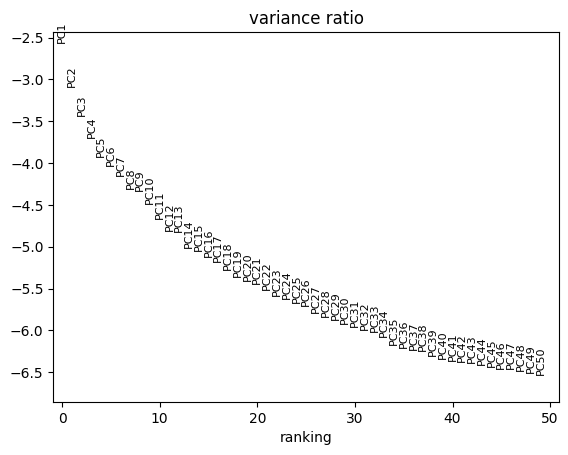

2025-06-06 10:48:47,742 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-06-06 10:49:00,675 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-06-06 10:49:00,876 - harmonypy - INFO - Iteration 1 of 20
2025-06-06 10:49:23,044 - harmonypy - INFO - Iteration 2 of 20
2025-06-06 10:49:45,522 - harmonypy - INFO - Iteration 3 of 20
2025-06-06 10:50:08,103 - harmonypy - INFO - Iteration 4 of 20
2025-06-06 10:50:30,611 - harmonypy - INFO - Iteration 5 of 20
2025-06-06 10:50:52,815 - harmonypy - INFO - Converged after 5 iterations


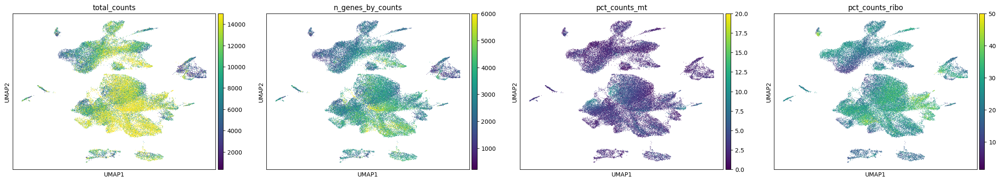

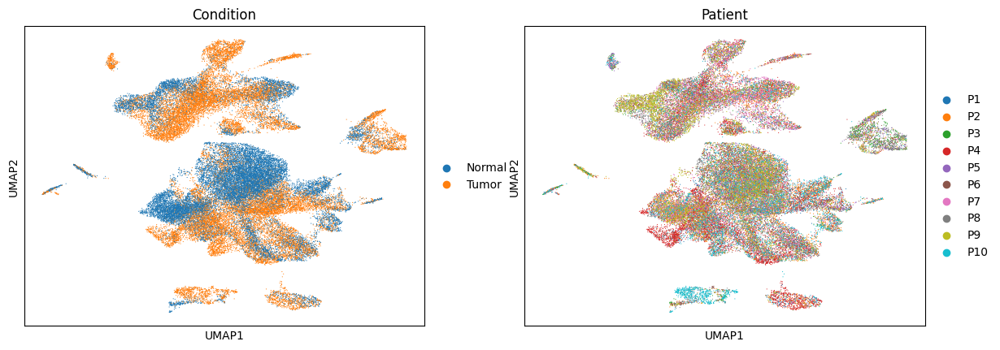

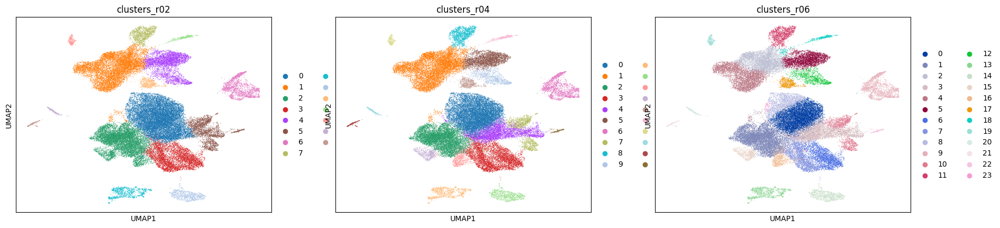

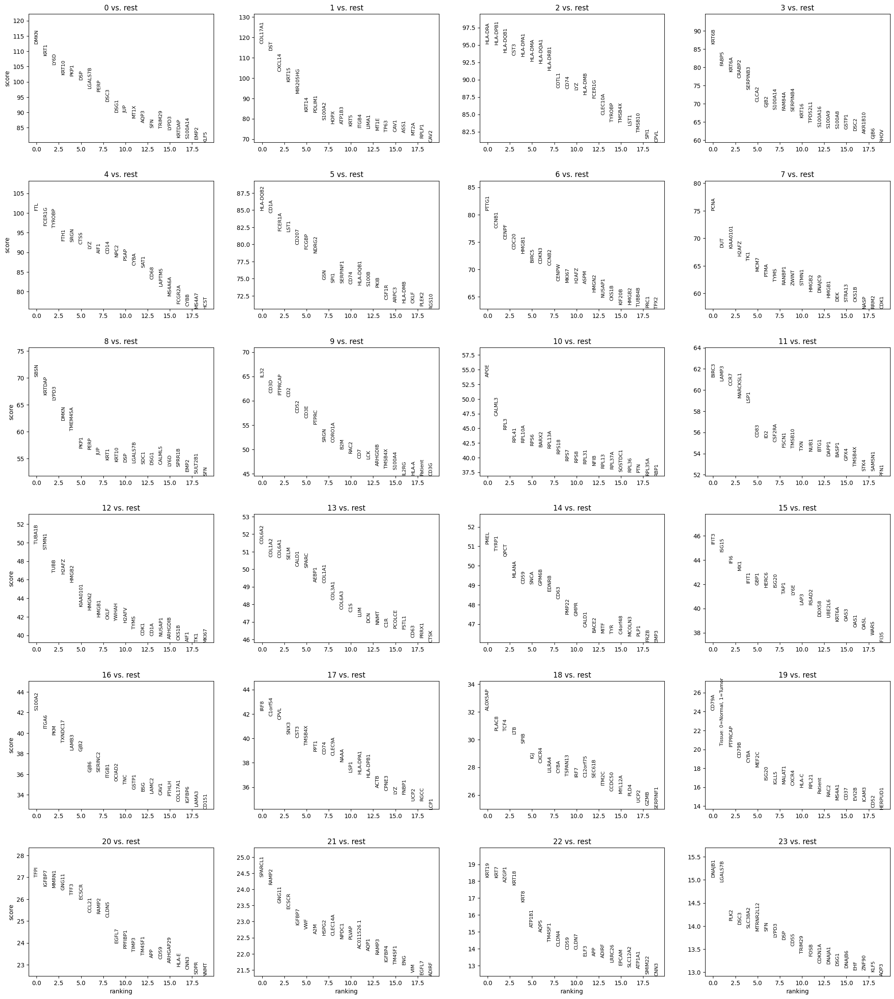

In [15]:
SCP.Runall(Ji)

       n_genes_by_counts   total_counts  pct_counts_mt  pct_counts_ribo
count      136490.000000  136490.000000  136490.000000    136490.000000
mean         1152.845300    3409.796908       2.653773        23.606667
std           899.594254    4652.889178       4.202914         9.119549
min            37.000000     376.000000       0.000000         0.304067
25%           555.000000    1038.000000       1.098207        17.369243
50%           870.000000    1952.000000       1.794872        23.020651
75%          1420.000000    3776.000000       2.936631        29.411765
max          9632.000000  132590.000000      97.193347        75.558795
       n_cells_by_counts   mean_counts  pct_dropout_by_counts  total_counts
count       32738.000000  32738.000000           32738.000000  3.273800e+04
mean         4806.397917      0.104154              96.478571  1.421599e+04
std         11825.832930      1.084813               8.664249  1.480661e+05
min             0.000000      0.000000          

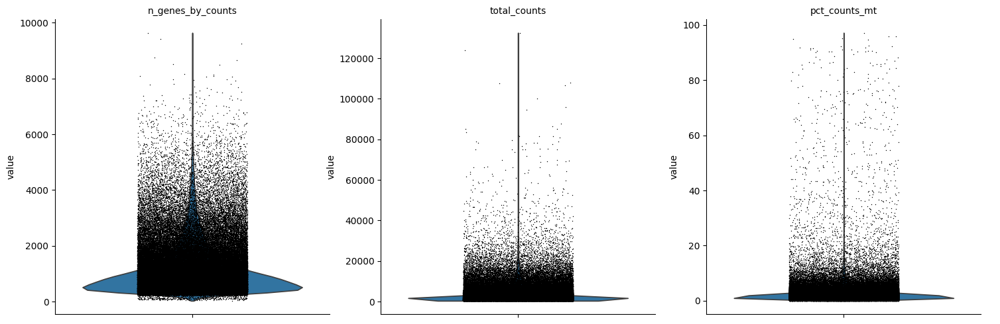

Total number of cells: 136490
Number of cells after mt filter: 135513
Number of cells after gene filter: 132473
Total number of genes: 32738
After mt genes removal:  32725
After ribo genes removal:  32619
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.85
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.3%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 0.3%
Elapsed time: 664.0 seconds
After removing doublets:  136489 cells
AnnData HVG dimensions:  (136490, 2000)
AnnData Raw dimensions:  (136490, 32738)


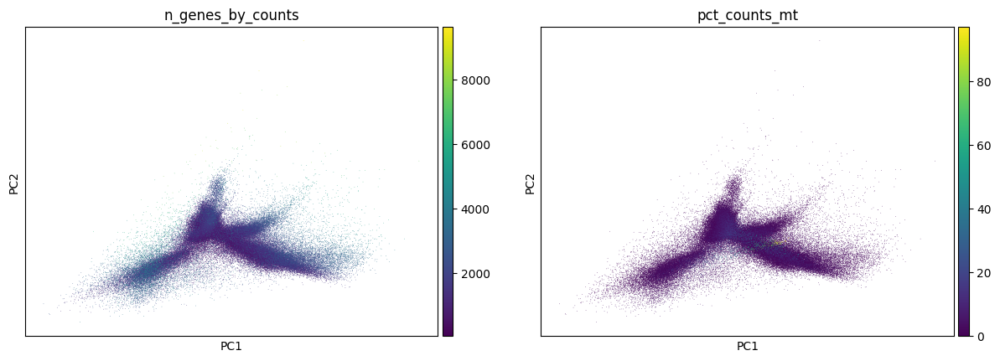

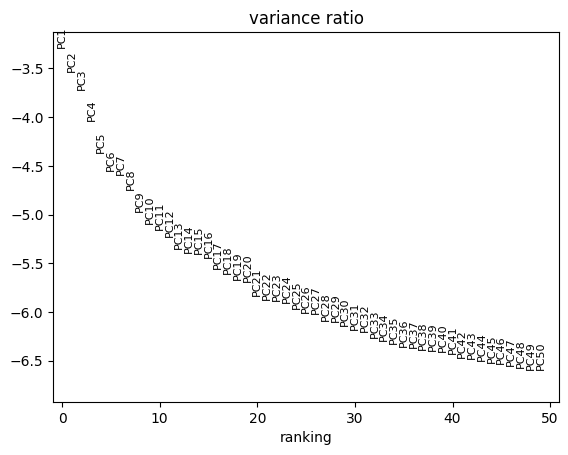

2025-06-06 11:13:41,165 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-06-06 11:14:16,630 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-06-06 11:14:17,304 - harmonypy - INFO - Iteration 1 of 20
2025-06-06 11:15:25,004 - harmonypy - INFO - Iteration 2 of 20
2025-06-06 11:16:32,584 - harmonypy - INFO - Iteration 3 of 20
2025-06-06 11:17:40,196 - harmonypy - INFO - Iteration 4 of 20
2025-06-06 11:18:47,167 - harmonypy - INFO - Iteration 5 of 20
2025-06-06 11:19:53,522 - harmonypy - INFO - Iteration 6 of 20
2025-06-06 11:20:31,454 - harmonypy - INFO - Iteration 7 of 20
2025-06-06 11:21:05,497 - harmonypy - INFO - Iteration 8 of 20
2025-06-06 11:21:36,249 - harmonypy - INFO - Converged after 8 iterations


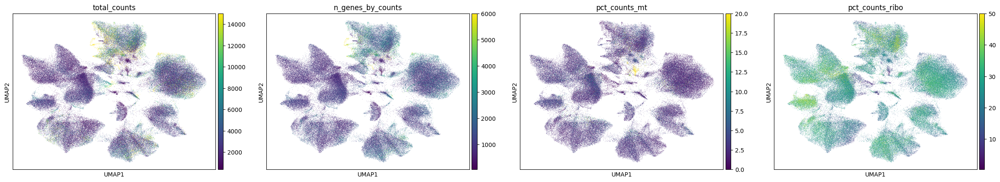

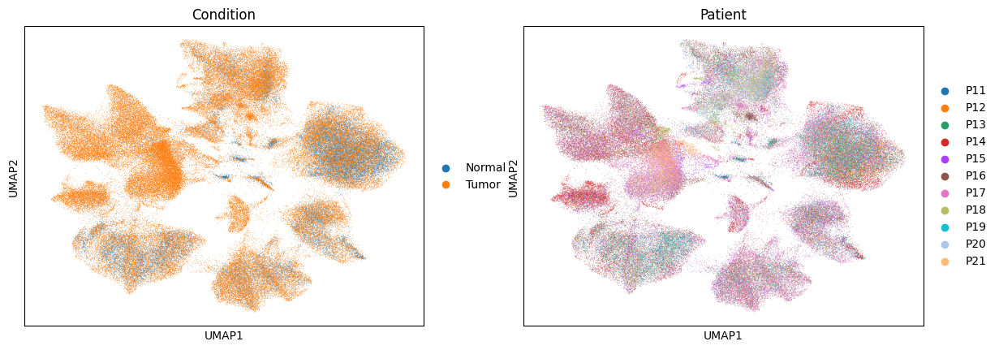

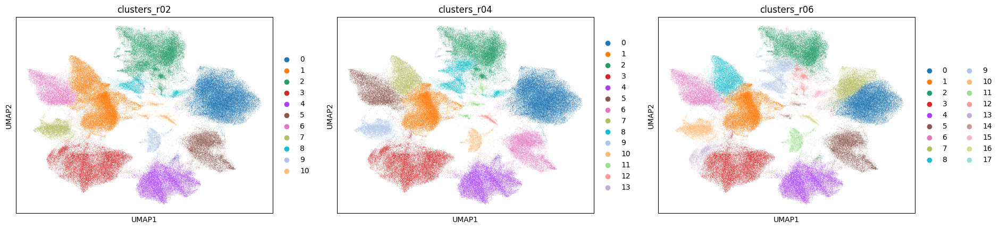

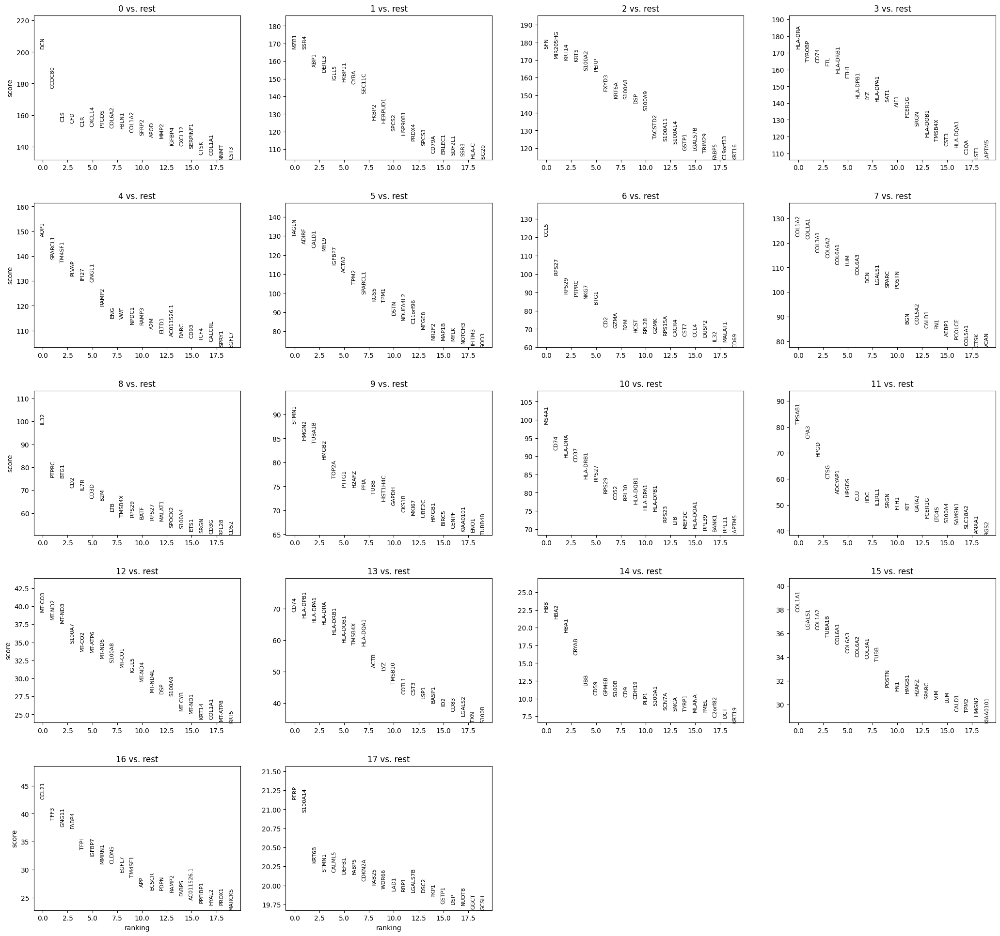

In [16]:
SCP.Runall(Lyko)

       n_genes_by_counts   total_counts  pct_counts_mt  pct_counts_ribo
count      134382.000000  134382.000000  134382.000000    134382.000000
mean         2680.726541   13382.514648       9.546452        23.431189
std          1523.457077   13069.154297      12.518263        10.232588
min            36.000000     500.000000       0.000000         0.166556
25%          1406.000000    3839.000000       4.381499        16.160207
50%          2646.000000   10314.000000       6.445084        23.784507
75%          3683.000000   18369.000000       9.298965        31.347739
max         10556.000000  241584.000000      98.391853        75.309464
       n_cells_by_counts   mean_counts  pct_dropout_by_counts  total_counts
count       33538.000000  33538.000000           33538.000000  3.353800e+04
mean        10741.290298      0.399025              92.006898  5.362178e+04
std         20912.731490      4.153427              15.562152  5.581423e+05
min             0.000000      0.000000          

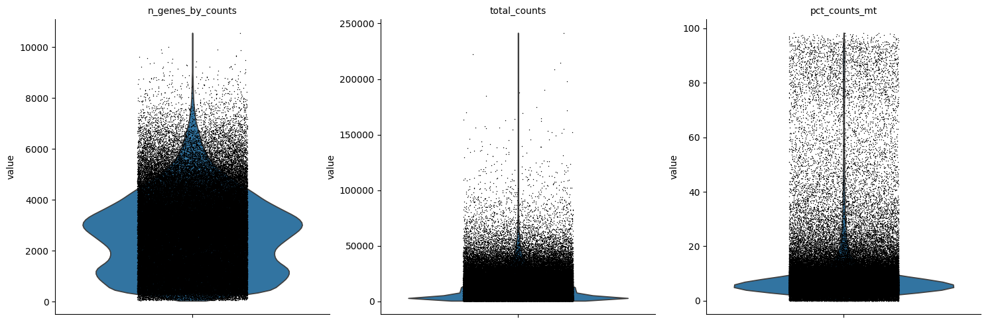

Total number of cells: 134382
Number of cells after mt filter: 124886
Number of cells after gene filter: 124647
Total number of genes: 33538
After mt genes removal:  33525
After ribo genes removal:  33421
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.60
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 5.7%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 1.1%
Elapsed time: 723.7 seconds
After removing doublets:  134300 cells
AnnData HVG dimensions:  (134382, 2000)
AnnData Raw dimensions:  (134382, 33538)


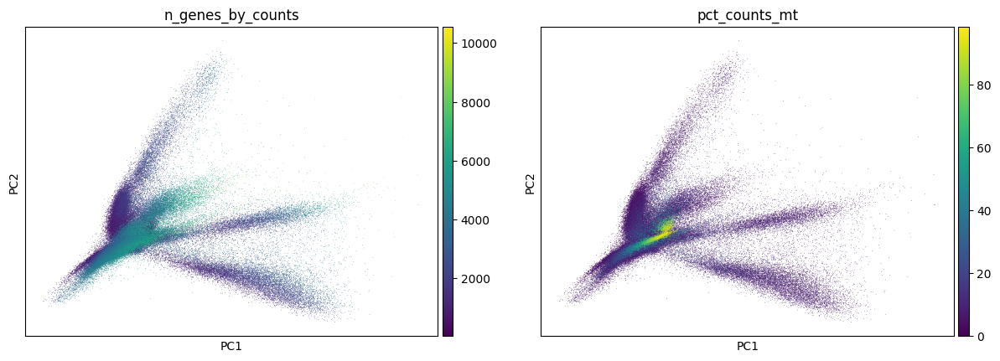

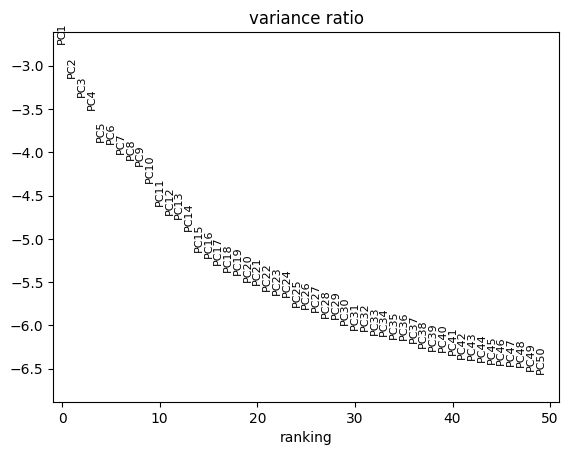

2025-06-06 11:59:55,979 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-06-06 12:00:31,048 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-06-06 12:00:31,699 - harmonypy - INFO - Iteration 1 of 20
2025-06-06 12:01:37,974 - harmonypy - INFO - Iteration 2 of 20
2025-06-06 12:02:43,926 - harmonypy - INFO - Iteration 3 of 20
2025-06-06 12:03:50,269 - harmonypy - INFO - Converged after 3 iterations


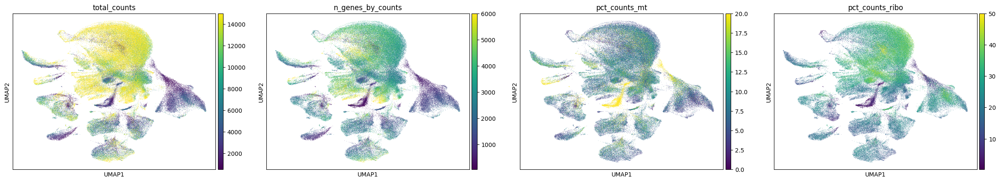

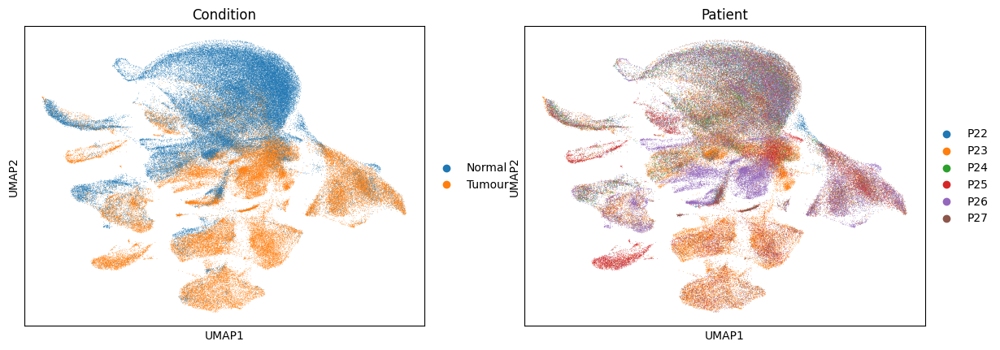

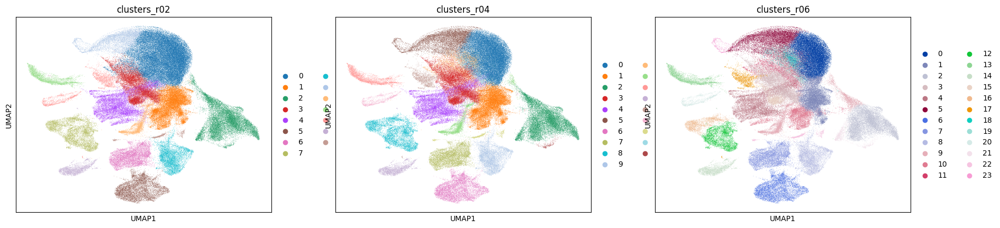

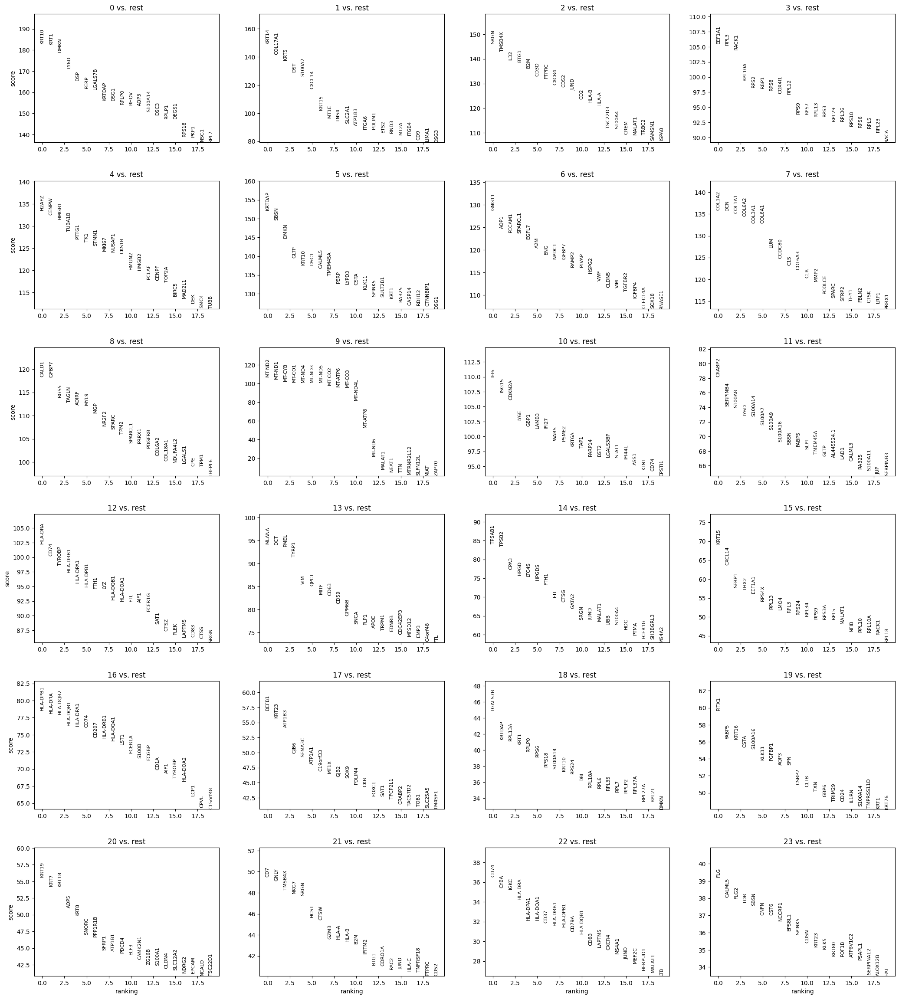

In [17]:
SCP.Runall(Zou)

# Annotation

In [28]:
#Markers for skin from CellMarker2.0
markers = pd.read_csv("Unzipped files/Skin_Markers.csv")
markers

,Species,Tissue Class,Tissue Type,Cancer,Cell name,Cell marker,Source,Supports,Detail
0,Human,Skin,Skin,Normal cell,T helper 2(Th2) cell,AADACL2,Experiment,1,DETAIL
1,Human,Skin,Skin,Cancer cell,Stem cell,ABCB5,Experiment,1,DETAIL
2,Human,Skin,Skin,Normal cell,CD4+ T cell,ABCG2,Experiment,1,DETAIL
3,Human,Skin,Skin,Normal cell,Keratinocyte progenitor cell,ABCG2,Experiment,1,DETAIL
4,Human,Skin,Skin,Normal cell,T helper 2(Th2) cell,ABO,Experiment,1,DETAIL
...,...,...,...,...,...,...,...,...,...
1116,Human,Skin,Skin,Normal cell,Dendritic cell,XCR1,Experiment,1,DETAIL
1117,Human,Skin,Skin,Normal cell,Dendritic cell,XIIIa,Experiment,1,DETAIL
1118,Human,Skin,Skin,Cancer cell,Cancer cell,ZAR1,Experiment,1,DETAIL
1119,Human,Skin,Skin,Normal cell,Innate lymphoid cell (ILCs),ZBTB16,Experiment,1,DETAIL


In [59]:
marker_dict = markers.groupby("Cell name")["Cell marker"].apply(list).to_dict()
marker_dict

categories: 0, 1, 2, etc.
var_group_labels: Activated T cell, Activated langerhans cell, Activated macrophage, etc.


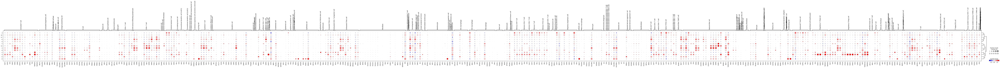

In [63]:
sc.tl.dendrogram(Yost, groupby='clusters_r06')

#Filtering genes to only those present in var names
filtered_dict = {
    cell_type: [gene for gene in genes if gene in Yost.var_names]
    for cell_type, genes in marker_dict.items()
}
#Dotplot to identify which cell type is most present in each cluster
sc.pl.rank_genes_groups_dotplot(
    Yost,
    groupby="clusters_r06",
    key="rank_genes_groups",
    var_names=filtered_dict,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-4,
    vmax=4,
    min_logfoldchange=1,
    colorbar_title="log fold change",
    save="Yost_marker_dotplot.pdf",
    show=True,
)

categories: 0, 1, 2, etc.
var_group_labels: Activated T cell, Activated langerhans cell, Activated macrophage, etc.


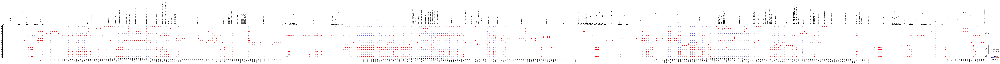

In [65]:
sc.tl.dendrogram(Lyko, groupby='clusters_r06')

#Filtering genes to only those present in var names
filtered_dict = {
    cell_type: [gene for gene in genes if gene in Lyko.var_names]
    for cell_type, genes in marker_dict.items()
}
#Dotplot to identify which cell type is most present in each cluster
sc.pl.rank_genes_groups_dotplot(
    Lyko,
    groupby="clusters_r06",
    key="rank_genes_groups",
    var_names=filtered_dict,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-4,
    vmax=4,
    min_logfoldchange=1,
    colorbar_title="log fold change",
    save="Lyko_marker_dotplot.pdf",
    show=True,
)

ERROR: the given dot_color_df data frame has a different shape than the data frame used for the dot size. Both data frames need to have the same index and columns
categories: 0, 1, 2, etc.
var_group_labels: Activated T cell, Activated langerhans cell, Activated macrophage, etc.


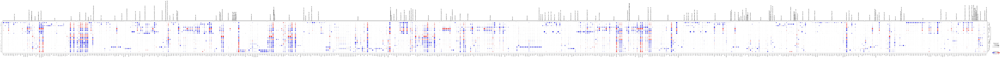

In [66]:
sc.tl.dendrogram(Ji, groupby='clusters_r04')

#Filtering genes to only those present in var names
filtered_dict = {
    cell_type: [gene for gene in genes if gene in Ji.var_names]
    for cell_type, genes in marker_dict.items()
}
#Dotplot to identify which cell type is most present in each cluster
sc.pl.rank_genes_groups_dotplot(
    Ji,
    groupby="clusters_r04",
    key="rank_genes_groups",
    var_names=filtered_dict,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-4,
    vmax=4,
    min_logfoldchange=1,
    colorbar_title="log fold change",
    save="Ji_marker_dotplot.pdf",
    show=True,
)

ERROR: the given dot_color_df data frame has a different shape than the data frame used for the dot size. Both data frames need to have the same index and columns
categories: 0, 1, 2, etc.
var_group_labels: Activated T cell, Activated langerhans cell, Activated macrophage, etc.


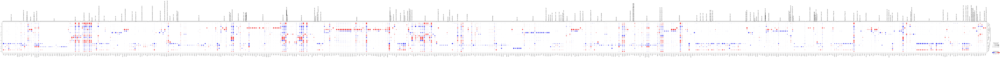

In [67]:
sc.tl.dendrogram(Zou, groupby='clusters_r04')

#Filtering genes to only those present in var names
filtered_dict = {
    cell_type: [gene for gene in genes if gene in Zou.var_names]
    for cell_type, genes in marker_dict.items()
}
#Dotplot to identify which cell type is most present in each cluster
sc.pl.rank_genes_groups_dotplot(
    Zou,
    groupby="clusters_r04",
    key="rank_genes_groups",
    var_names=filtered_dict,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-4,
    vmax=4,
    min_logfoldchange=1,
    colorbar_title="log fold change",
    save="Zou_marker_dotplot.pdf",
    show=True,
)